# OCR

In [1]:
#from PIL import Image
import cv2
import numpy as np
import matplotlib.pyplot as plt
#import pytesseract

In [2]:
image_path = 'input/1.png'
img = cv2.imread(image_path)
img_original = img.copy()

In [24]:
#https://stackoverflow.com/questions/28816046/
#displaying-different-images-with-actual-size-in-matplotlib-subplot
def display(im_path):
    dpi = 80
    im_data = plt.imread(im_path)

    height, width = im_data.shape[:2]
    
    # What size does the figure need to be in inches to fit the image?
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image.
    ax.imshow(im_data, cmap='gray')

    plt.show()

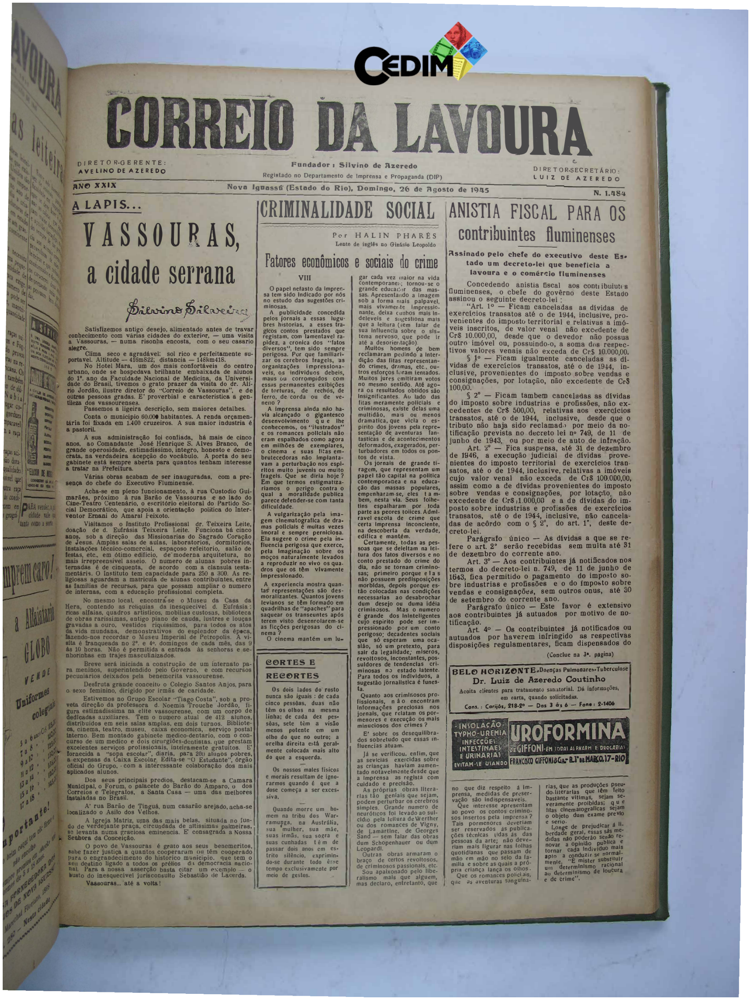

In [4]:
display(image_path)

# Preparações

## Binarizando a imagem

In [5]:
def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

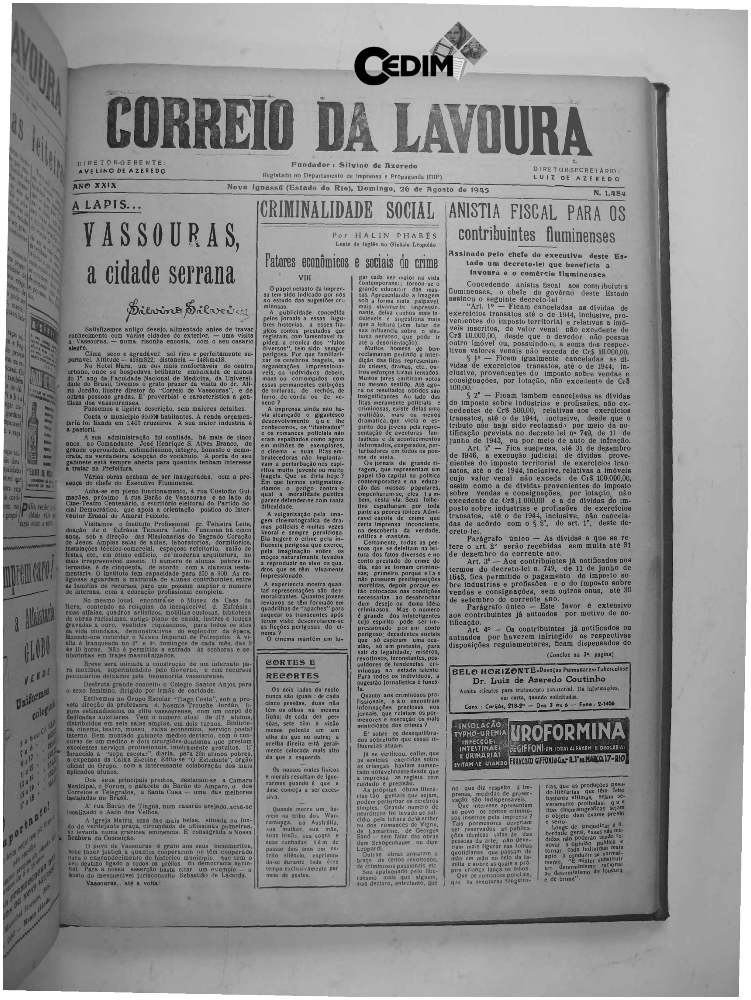

In [6]:
img_gray = grayscale(img)
cv2.imwrite('temp/gray.png', img_gray)
display('temp/gray.png')

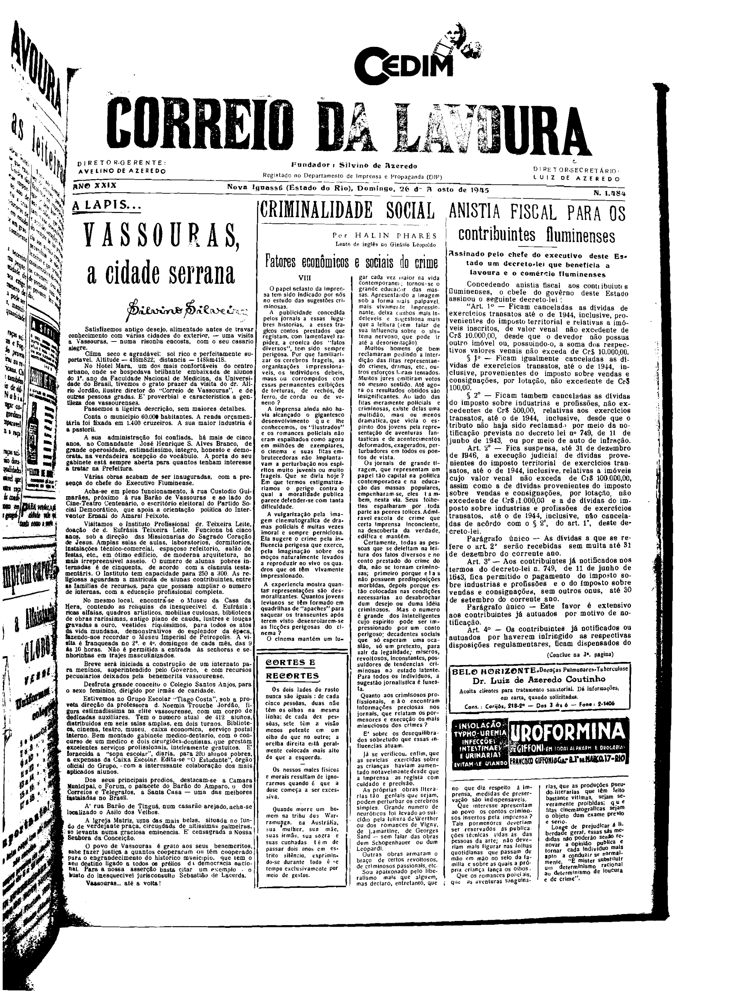

In [7]:
thresh, img_bw = cv2.threshold(img_gray, 100, 255, cv2.THRESH_BINARY)
cv2.imwrite('temp/bw.png', img_bw)
display('temp/bw.png')

## Remoção de Noise

In [33]:
def remove_noise(image, k=1):
    kernel = np.ones((k,k), np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    #kernel = np.ones((1,1), np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
    image = cv2.medianBlur(image, 3)
    return image

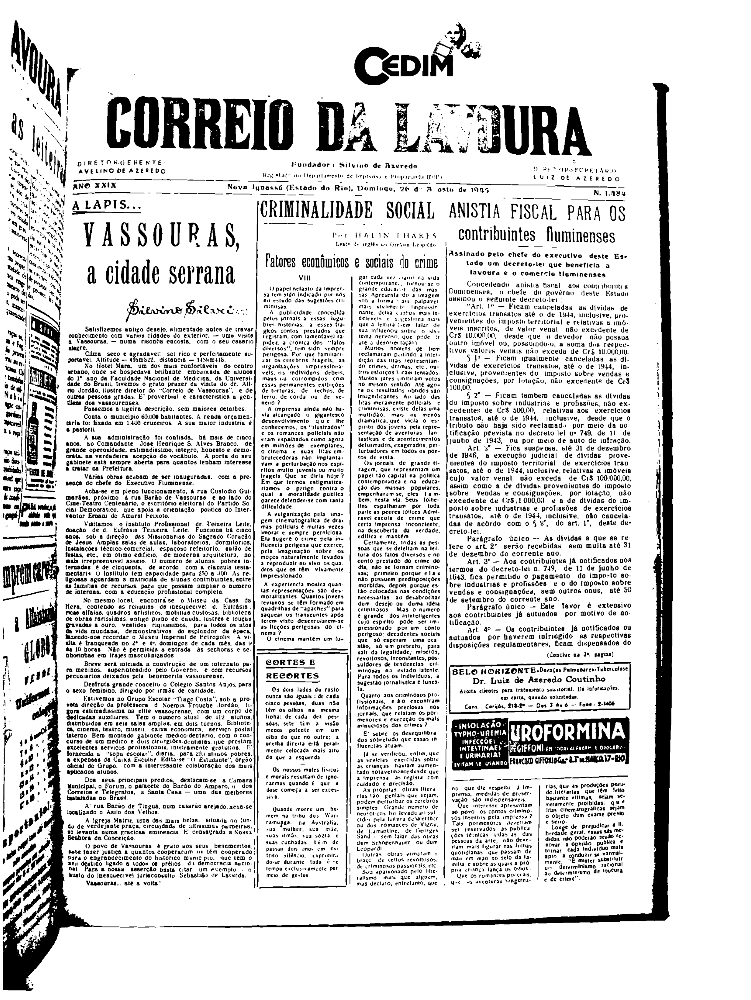

In [9]:
img_no_noise = remove_noise(img_bw)
cv2.imwrite('temp/no_noise.png', img_no_noise)
display('temp/no_noise.png')

## OCR com PyTesseract

In [10]:
from PIL import Image
import pytesseract

In [173]:
import re
def remove_extra_spaces(text):
    splitted = [line.strip() for line in text.splitlines() if len(line.strip()) > 0]
    text = '\n'.join(splitted)
    text = re.sub(' +', ' ', text)
    return text

def treat_hyphenation(text):
    text = re.sub('-\n', '', text)
    return text

In [172]:
def run_ocr(image_path, output_path):
    img = Image.open(image_path)
    result = pytesseract.image_to_string(img, lang='por')
    result = remove_extra_spaces(result)
    result = treat_hyphenation(result)
    with open(output_path, 'w', encoding='utf-8') as f:
        f.write(result)

In [174]:
%time run_ocr('input/1.png', 'output/plain.txt')
%time run_ocr('temp/bw.png', 'output/bw.txt')

Wall time: 15.8 s
Wall time: 12.9 s


## Pegar o conteúdo principal

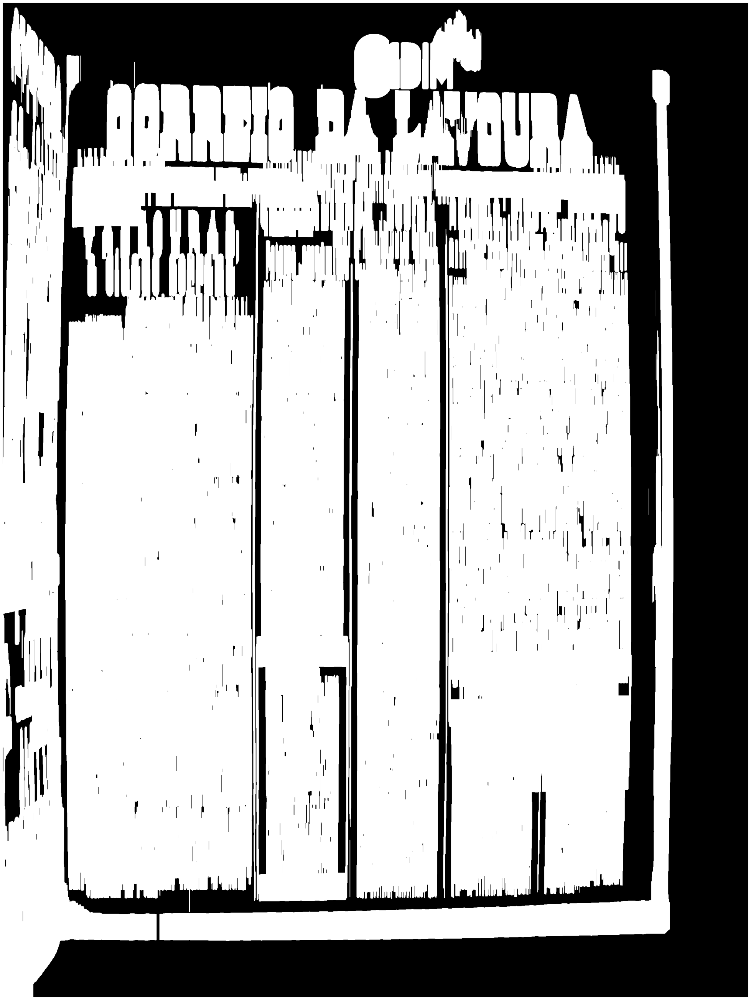

In [26]:
#img = cv2.imread(image_path)
blur = cv2.GaussianBlur(img_bw, (7, 7), 0)
thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (1, 75))
dilate = cv2.dilate(thresh, kernel, iterations=1)

cv2.imwrite('temp/m_dilate.png', dilate)
display('temp/m_dilate.png')

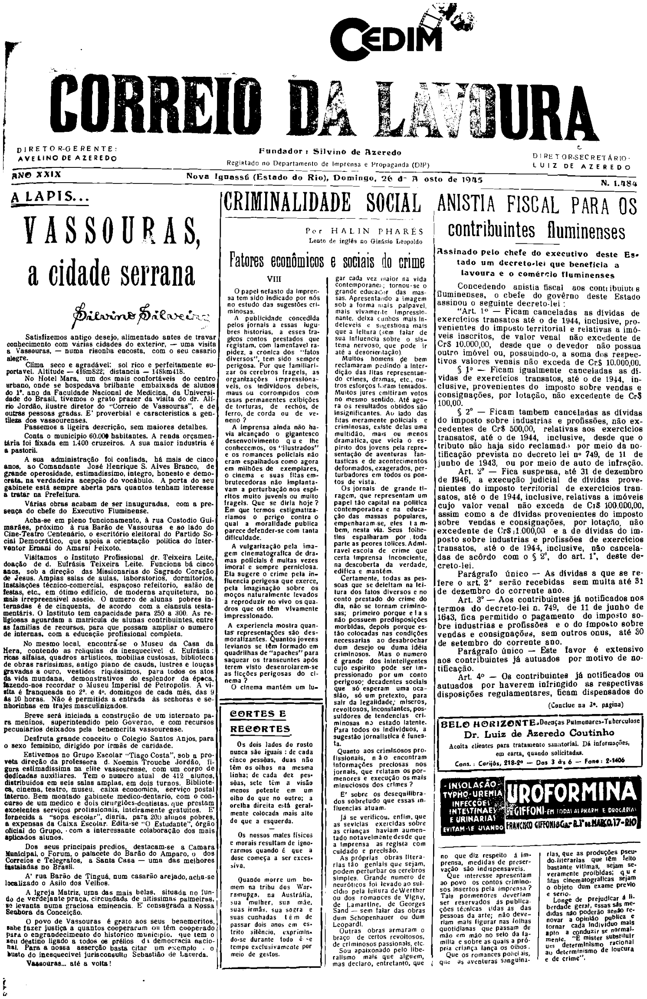

In [27]:
cnts = cv2.findContours(dilate, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = sorted(cnts, key=lambda x: cv2.contourArea(x))
cnt = cnts[-1] # select largest
x, y, w, h = cv2.boundingRect(cnt)

img_main = img_bw[y:y+h, x:x+w]
cv2.imwrite(f'temp/main_body.png', img_main)
display('temp/main_body.png')

## Separando as colunas

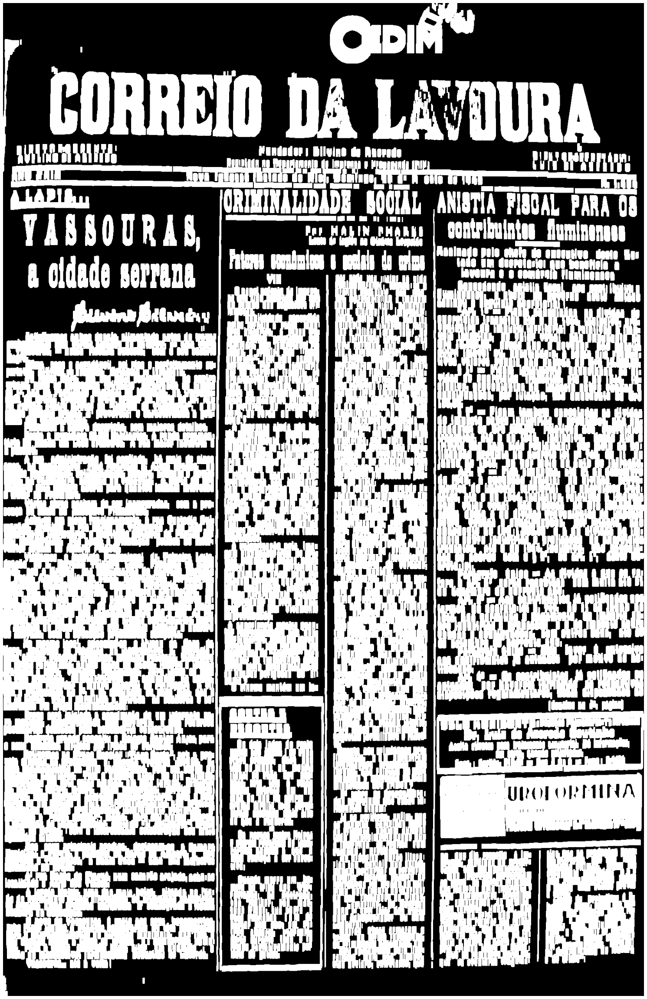

In [33]:
blur = cv2.GaussianBlur(img_main, (5, 5), 0)
thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 13))
dilate = cv2.dilate(thresh, kernel, iterations=1)
cv2.imwrite('temp/dilate.png', dilate)
display('temp/dilate.png')

In [36]:
def contains(columns, x, y, w, h):
    for c in columns:
        x1, y1, w1, h1 = c
        if x >= x1 and x + w <= x1 + w1 and y >= y1 and y + h <= y1 + h1:
            return True
    
    return False

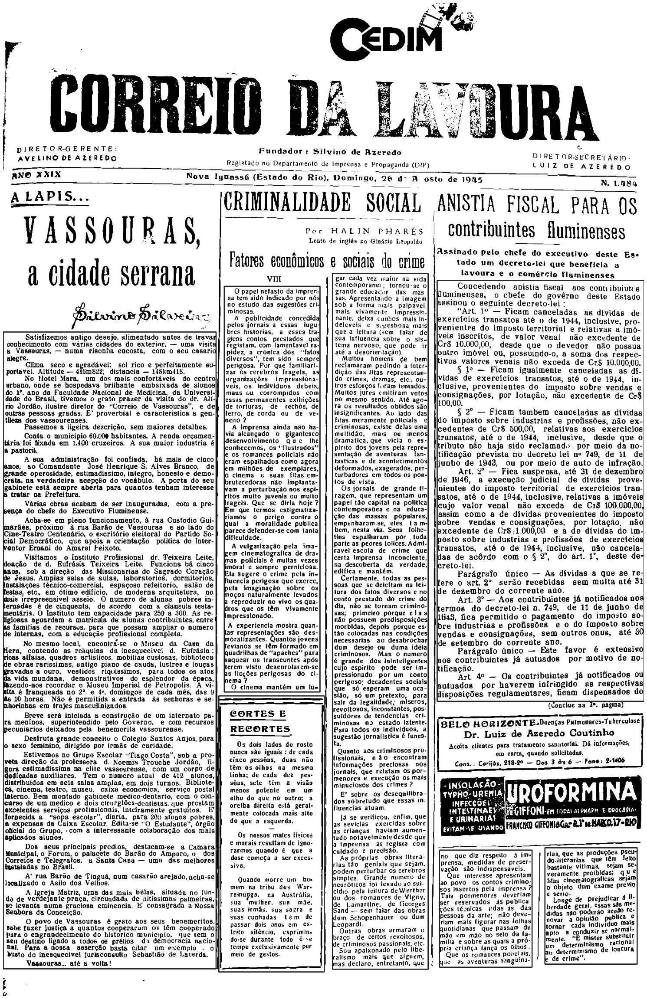

In [38]:
img = img_main.copy()
cnts = cv2.findContours(dilate, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = sorted(cnts, key=lambda x: cv2.boundingRect(x)[0])
i = 0
columns = []
for c in cnts:
    x, y, w, h = cv2.boundingRect(c)
    if h > 200 and w > 150 and not contains(columns, x, y, w, h):
        columns.append((x, y, w, h))
        roi = img[y:y+h, x:x+w]
        cv2.imwrite(f'temp/columns/roi_{i}.png', roi)
        cv2.rectangle(img, (x, y), (x+w, y+h), (36, 255, 12), 2)
        i += 1
cv2.imwrite('temp/boxes.png', img)
display('temp/boxes.png')

## OCR das colunas

In [177]:
for i in range(len(columns)):
    roi = f'temp/columns/roi_{i}.png'
    out = f'output/columns/roi_{i}.txt'
    %time run_ocr(roi, out)

result = []
for i in range(len(columns)):
    roi = f'output/columns/roi_{i}.txt'
    with open(roi, encoding='utf-8') as f:
        result.append(f.read())
result = '\n\n'.join(result)
with open('output/columns.txt', 'w', encoding='utf-8') as f:
    f.write(result)

Wall time: 3.98 s
Wall time: 720 ms
Wall time: 1.62 s
Wall time: 3.2 s
Wall time: 3.17 s
Wall time: 940 ms
Wall time: 402 ms


# Estudos

In [4]:
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_gray.shape

(2880, 2160)

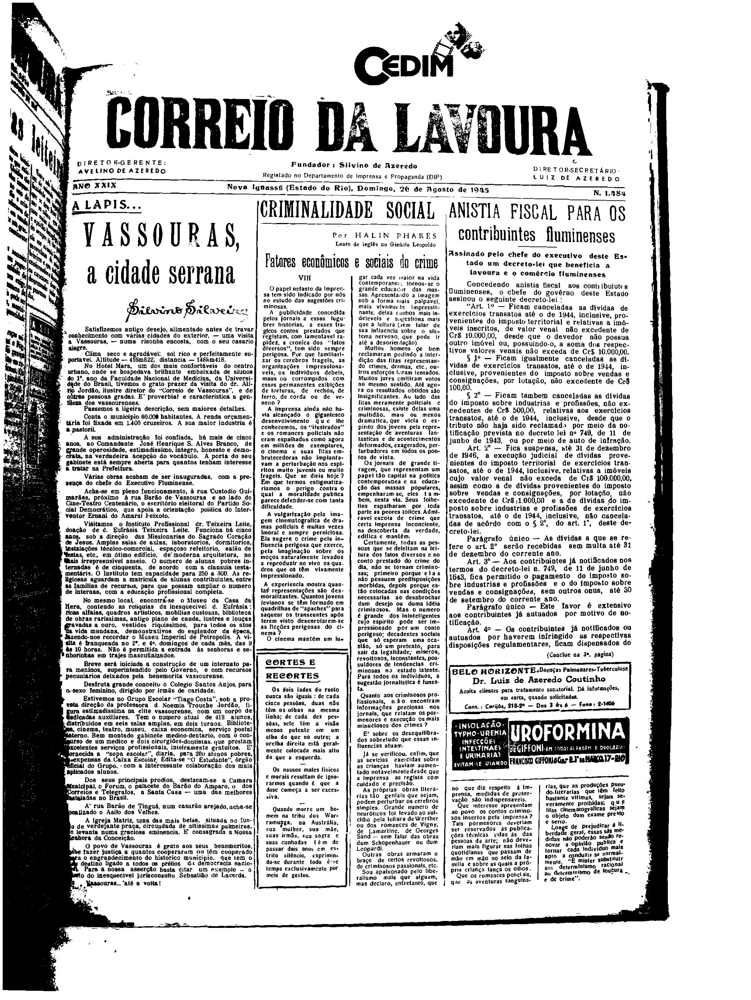

In [5]:
thresh, img_bw = cv2.threshold(img_gray, 100, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
cv2.imwrite('temp/bw.png', img_bw)
display('temp/bw.png')

## Detectando conteúdo

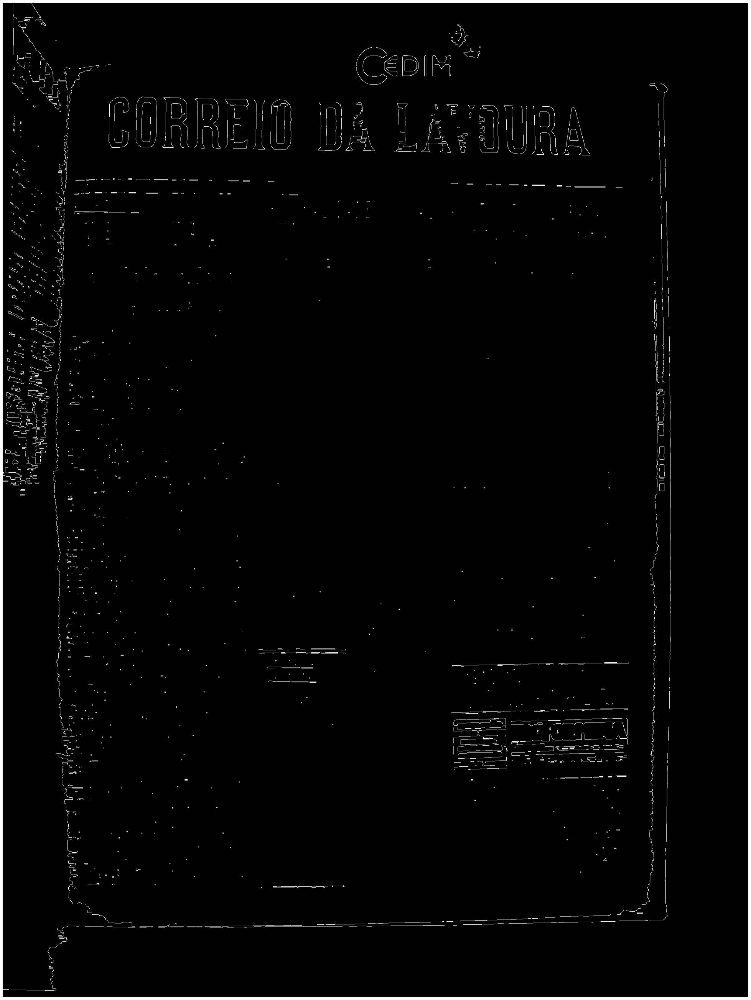

In [51]:
blur = cv2.GaussianBlur(img_bw, (5, 5), 0)
thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (13, 3))
erode = cv2.erode(thresh, kernel, iterations=1)

low_threshold = 50
high_threshold = 150
edges = cv2.Canny(erode, low_threshold, high_threshold)
cv2.imwrite('temp/lines.png', edges)
display('temp/lines.png')

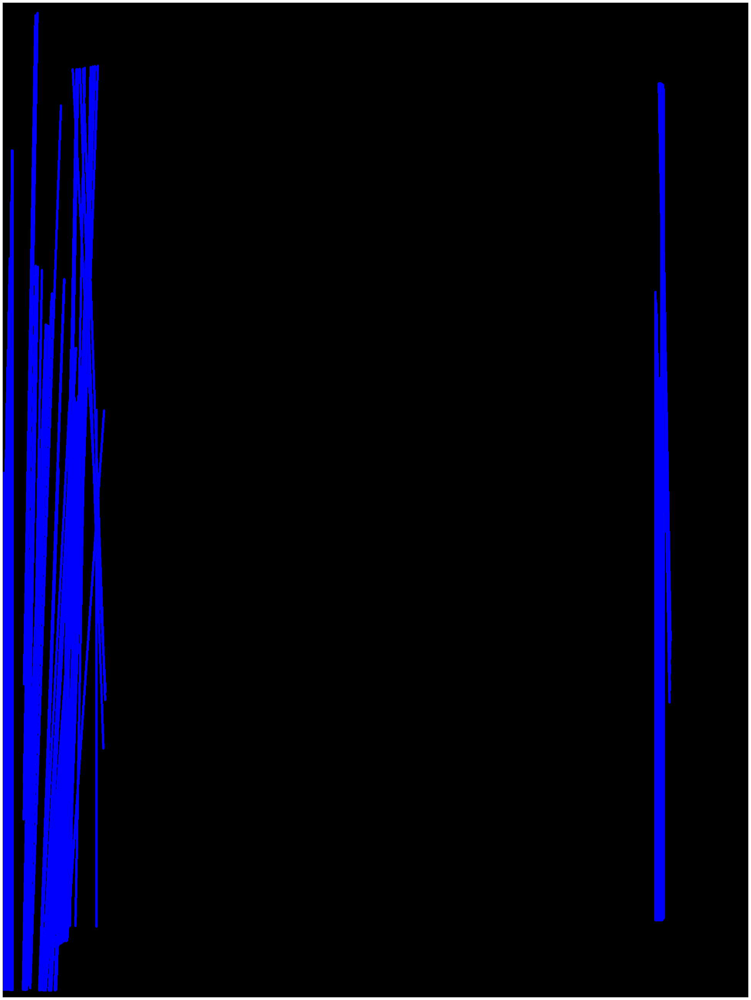

In [52]:
rho = 1  # distance resolution in pixels of the Hough grid
theta = np.pi / 180  # angular resolution in radians of the Hough grid
threshold = 7  # minimum number of votes (intersections in Hough grid cell)
min_line_length = 20  # minimum number of pixels making up a line
max_line_gap = 500  # maximum gap in pixels between connectable line segments
line_image = np.copy(img) * 0  # creating a blank to draw lines on

# Run Hough on edge detected image
# Output "lines" is an array containing endpoints of detected line segments
lines = cv2.HoughLinesP(erode, rho, theta, threshold, np.array([]), min_line_length, max_line_gap)

long_lines = []
grouped_lines = ([], [])
for line in lines:
    for x1,y1,x2,y2 in line:
        if abs(y2 - y1) > line_image.shape[0] * 0.5 and abs(y2-y1) < line_image.shape[0] * 0.9:
            long_lines.append((x1, y1, x2, y2))
            if x1 < line_image.shape[1] * 0.5: grouped_lines[0].append((x1, y1, x2, y2))
            else: grouped_lines[1].append((x1, y1, x2, y2))
            cv2.line(line_image,(x1,y1),(x2,y2),(255,0,0),5)
cv2.imwrite('temp/lines.png', line_image)
display('temp/lines.png')

In [49]:
lines = []
line = None
h = 1e10
for group in grouped_lines:
    x = np.mean([np.mean([line[0], line[2]]) for line in group], dtype=int)
    y1 = np.min([min(line[1], line[3]) for line in group],)
    y2 = np.max([max(line[1], line[3]) for line in group])
    lines.append((x, y1, x, y2))
    if y2 - y1 < h:
        line = (x, y1, x, y2)
        h = y2-y1

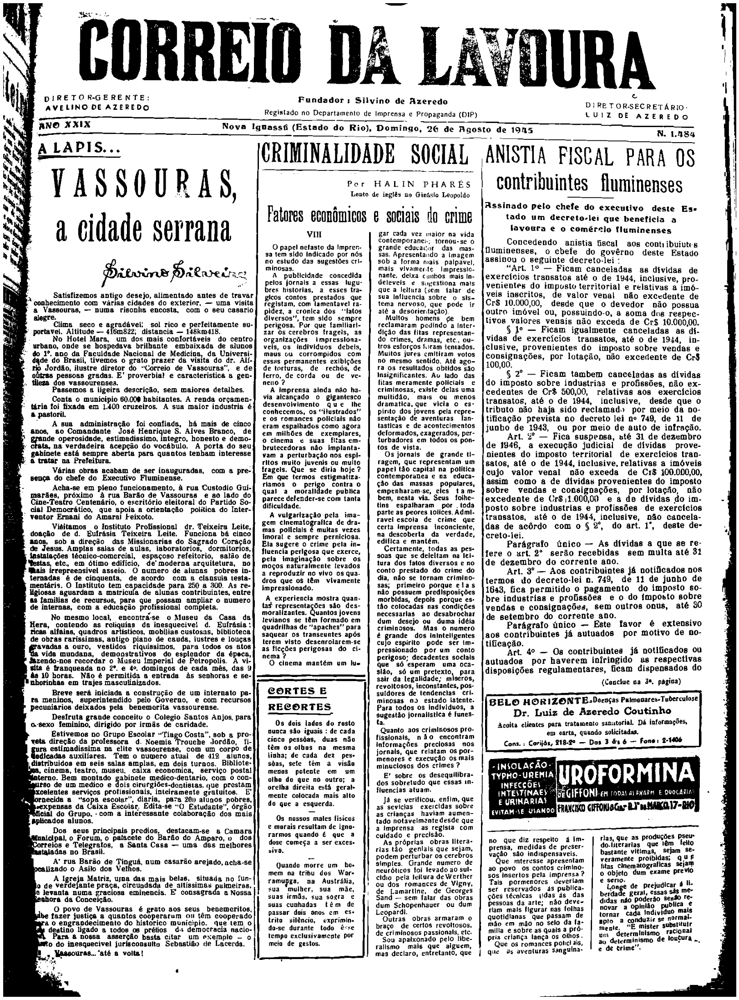

In [50]:
long_line = line#sorted(long_lines, key=lambda x: abs(x[1] - x[3]))[-1]
x1 = min(lines[0][0], lines[1][2])
x2 = max(lines[0][0], lines[1][2])
y1, y2 = min(long_line[1], long_line[3]), max(long_line[1], long_line[3])
content = img_bw[y1:y2,x1:x2]
cv2.imwrite('temp/content.png', content)
display('temp/content.png')

## Detectando conteúdo - segunda forma

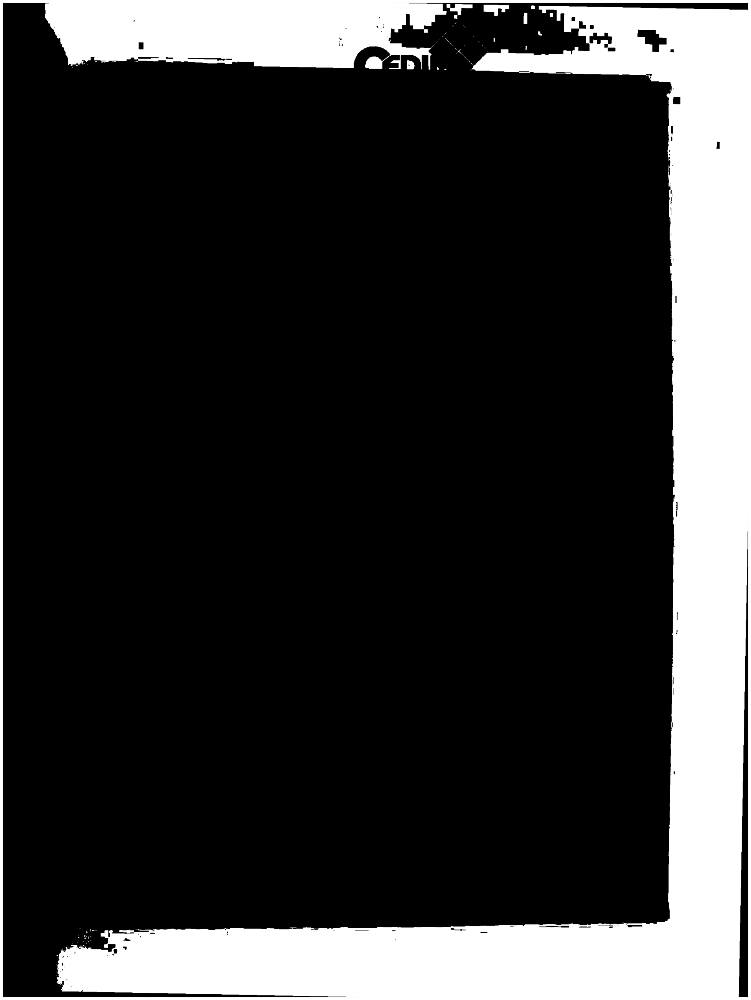

In [37]:
#convert the BGR image to HSV colour space
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
# cv2.imwrite('temp/hsv.png', hsv)
# display('temp/hsv.png')

#set the lower and upper bounds for the green hue
lower_bg = (95, 50, 150)
upper_bg = (115, 80, 230)

#create a mask for green colour using inRange function
mask = cv2.inRange(hsv, lower_bg, upper_bg)
cv2.imwrite('temp/bg_mask.png', mask)
display('temp/bg_mask.png')

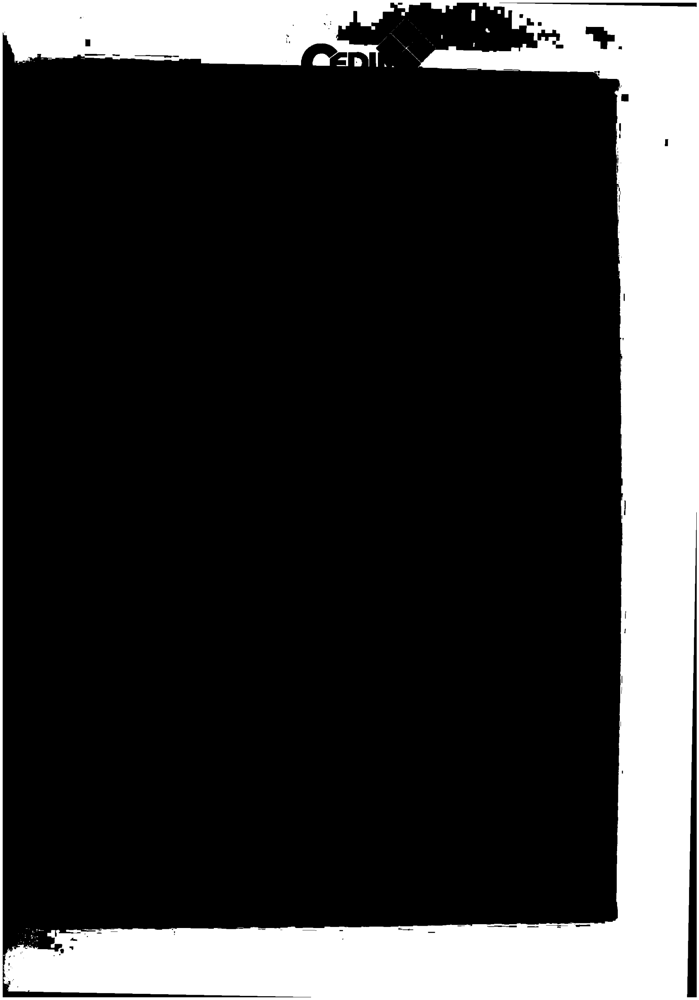

In [38]:
cnts = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = sorted(cnts, key=lambda x: cv2.contourArea(x))
cnt = cnts[-1] # select largest
x, y, w, h = cv2.boundingRect(cnt)

mask = mask[y:y+h, x:x+w]
cv2.imwrite('temp/main_mask.png', mask)
display('temp/main_mask.png')

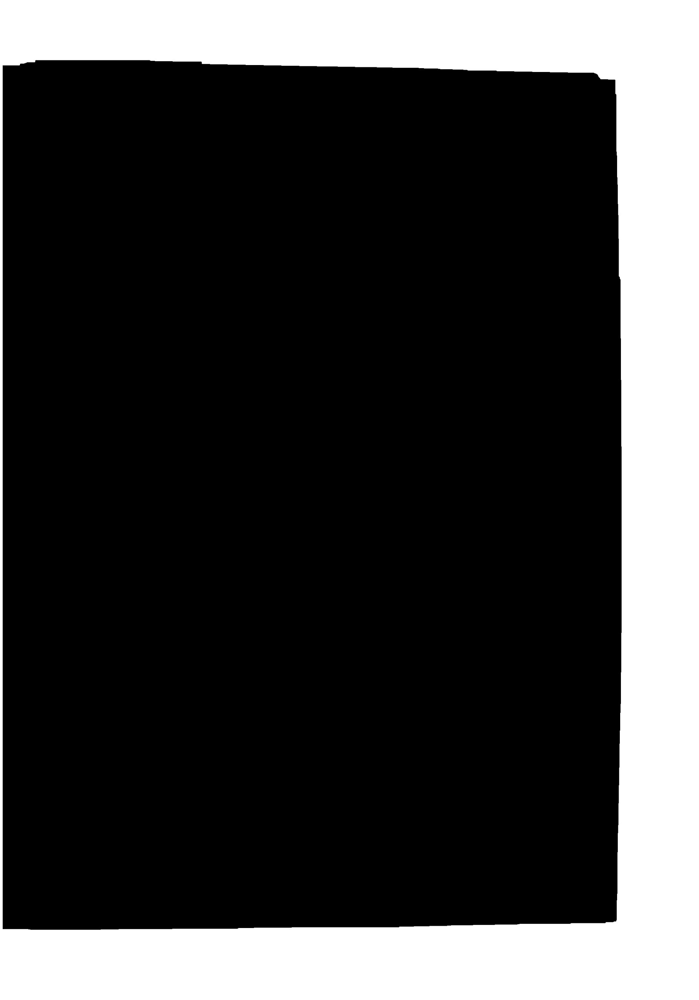

In [39]:
no_noise = remove_noise(mask, 200)
cv2.imwrite('temp/no_noise.png', no_noise)
display('temp/no_noise.png')

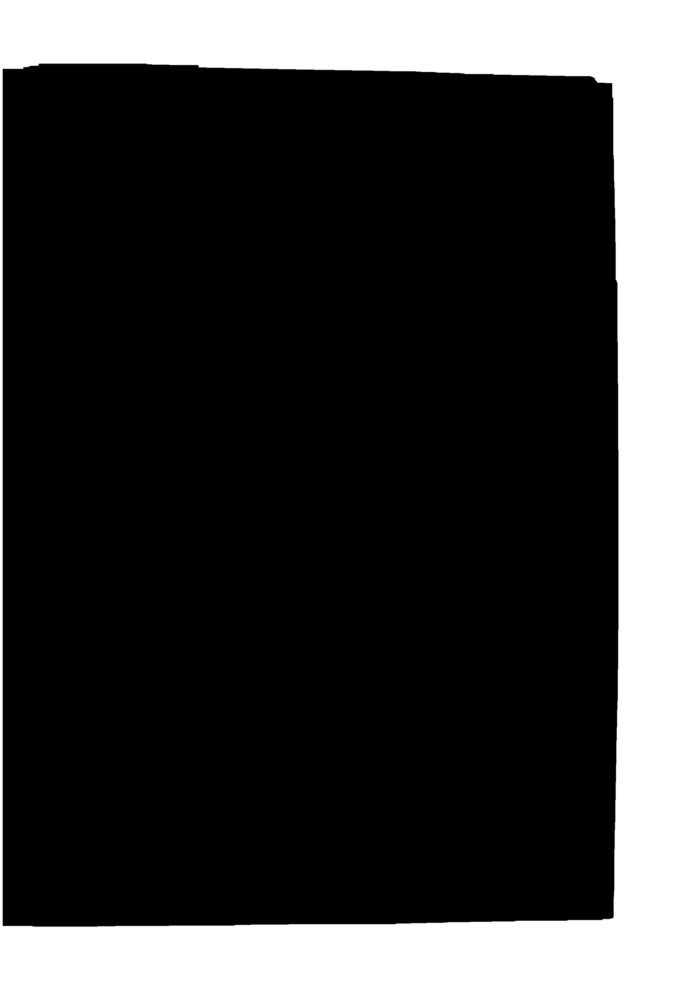

In [40]:
kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(20,20))
no_noise = cv2.dilate(no_noise, kernel, iterations=1)
cv2.imwrite('temp/dilate.png', no_noise)
display('temp/dilate.png')

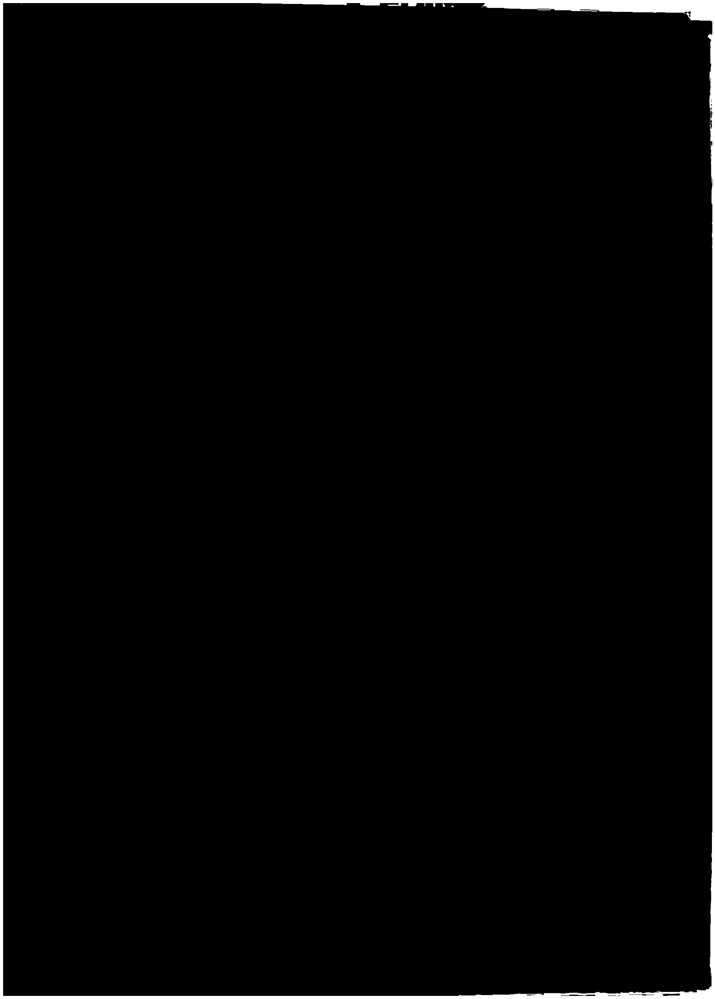

In [41]:
_, no_noise = cv2.threshold(no_noise, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
cnts = cv2.findContours(no_noise, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = sorted(cnts, key=lambda x: cv2.contourArea(x))
cnt = cnts[-1] # select largest
x, y, w, h = cv2.boundingRect(cnt)

mask = mask[y:y+h, x:x+w]
cv2.imwrite('temp/main_mask.png', mask)
display('temp/main_mask.png')

## Separando o cabeçalho

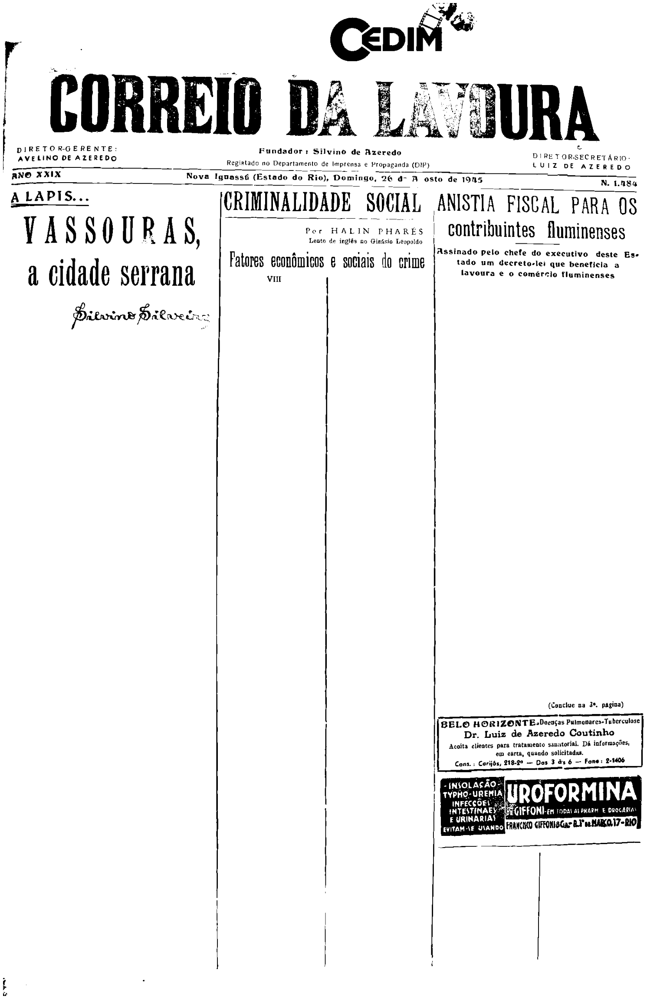

In [85]:
img_no_columns = img_main.copy()
for c in columns:
    x, y, w, h = c
    cv2.rectangle(img_no_columns, (x, y), (x+w, y+h), (255, 255, 255), -1)
cv2.imwrite('temp/no_columns.png', img_no_columns)
display('temp/no_columns.png')

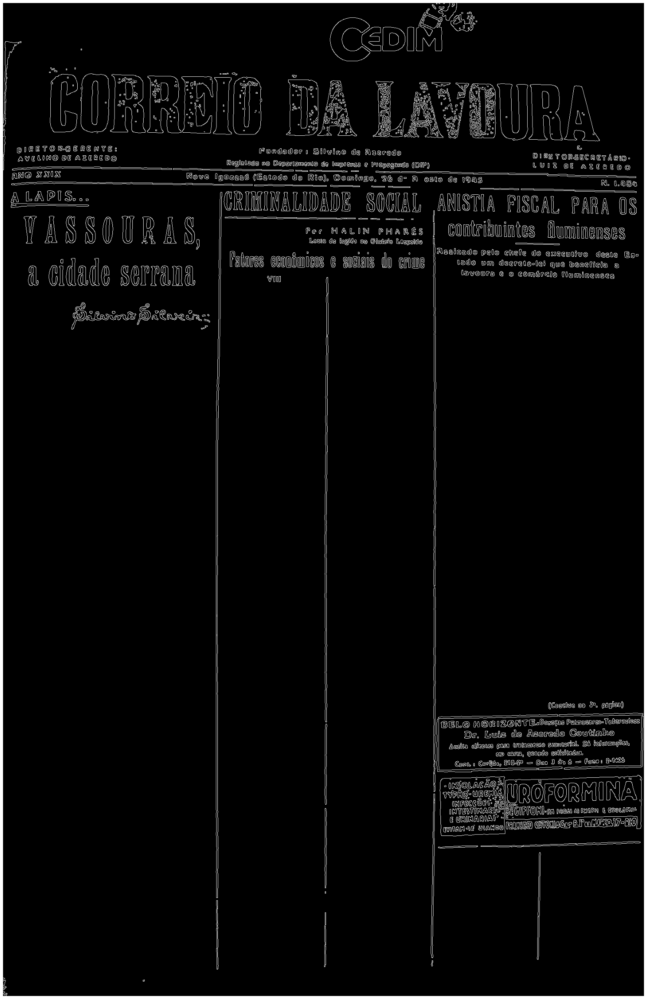

In [124]:
blur = cv2.GaussianBlur(img_no_columns, (5, 5), 0)
# thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
# kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 3))
# dilate = cv2.dilate(thresh, kernel, iterations=1)

low_threshold = 50
high_threshold = 150
edges = cv2.Canny(blur, low_threshold, high_threshold)
cv2.imwrite('temp/lines.png', edges)
display('temp/lines.png')

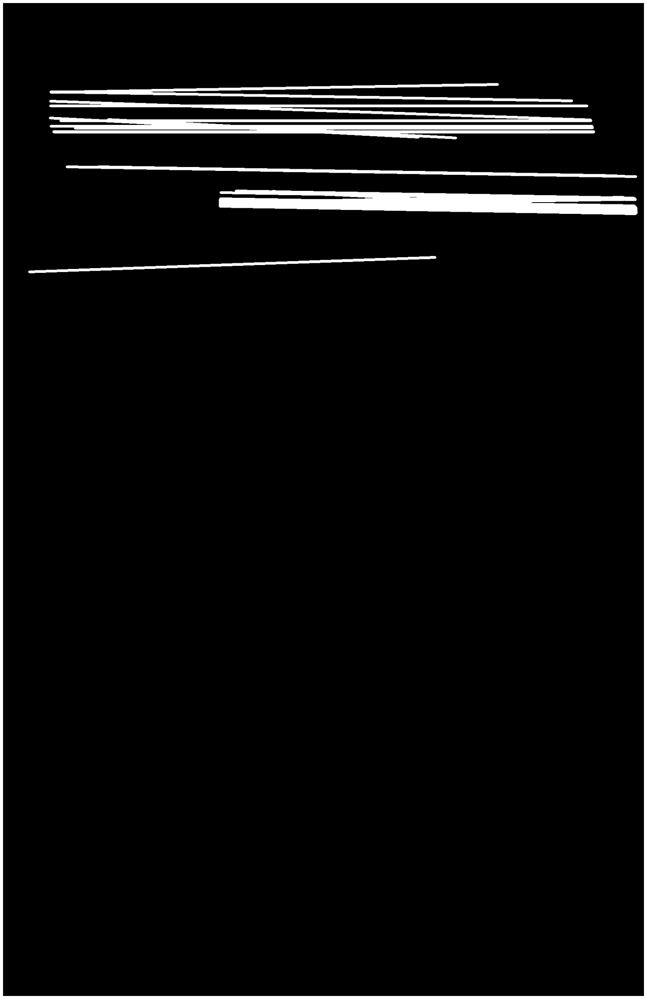

In [138]:
rho = 1  # distance resolution in pixels of the Hough grid
theta = np.pi / 180  # angular resolution in radians of the Hough grid
threshold = 7  # minimum number of votes (intersections in Hough grid cell)
min_line_length = 20  # minimum number of pixels making up a line
max_line_gap = 100  # maximum gap in pixels between connectable line segments
line_image = np.copy(img) * 0  # creating a blank to draw lines on

# Run Hough on edge detected image
# Output "lines" is an array containing endpoints of detected line segments
lines = cv2.HoughLinesP(edges, rho, theta, threshold, np.array([]),
                    min_line_length, max_line_gap)

long_lines = []
for line in lines:
    for x1,y1,x2,y2 in line:
        if abs(x2 - x1) > line_image.shape[1] * 0.5 and abs(y2 - y1) < 50:
            long_lines.append((x1, y1, x2, y2))
            cv2.line(line_image,(x1,y1),(x2,y2),(255,0,0),5)
cv2.imwrite('temp/lines.png', line_image)
display('temp/lines.png')

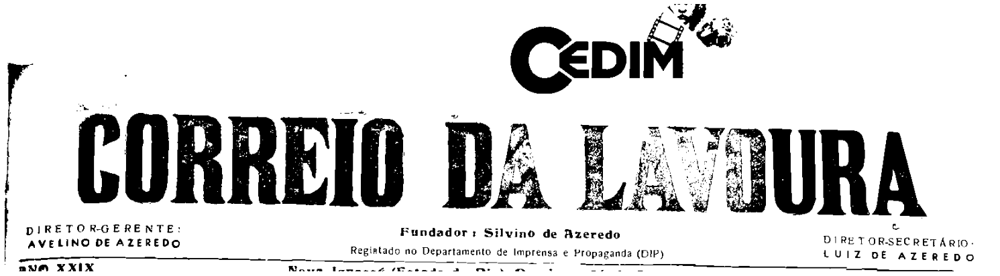

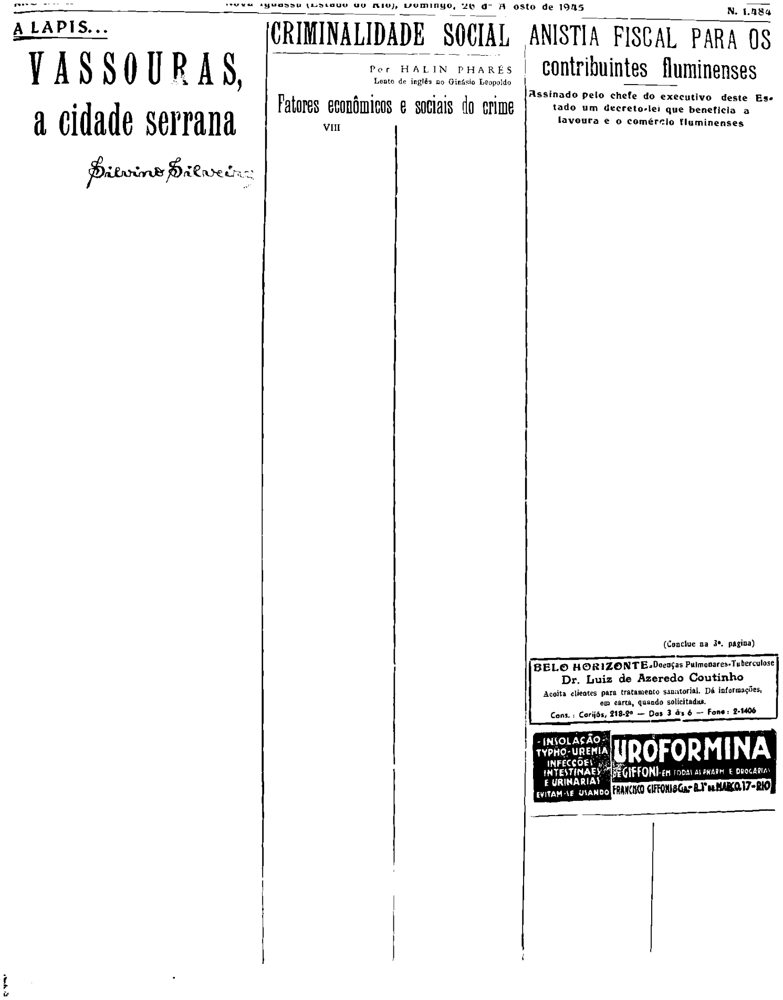

In [139]:
long_line = sorted(long_lines, key=lambda x: abs(x[0] - x[2]))[-1]
header_y = max(long_line[1], long_line[3])
img_header = img_no_columns[0:header_y,:]
cv2.imwrite('temp/header.png', img_header)
img_body = img_no_columns[header_y:,:]
cv2.imwrite('temp/body.png', img_body)
display('temp/header.png')
display('temp/body.png')

## Capturando os títulos

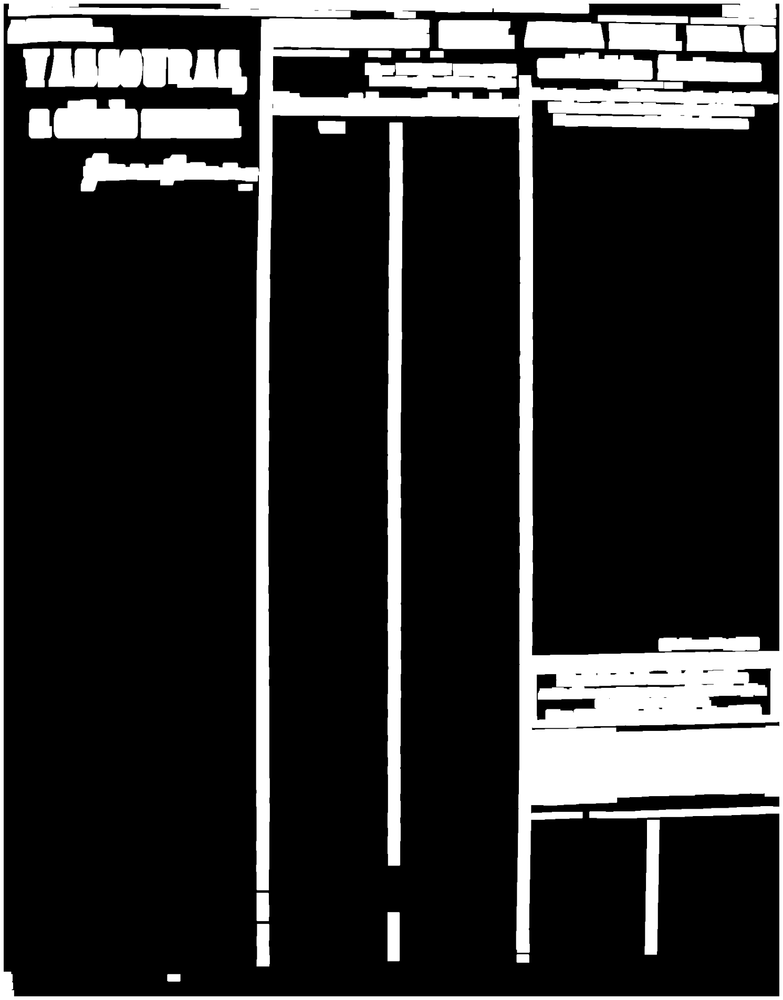

In [167]:
blur = cv2.GaussianBlur(img_body, (5, 5), 0)
thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (25, 13))
dilate = cv2.dilate(thresh, kernel, iterations=1)
cv2.imwrite('temp/dilate.png', dilate)
display('temp/dilate.png')

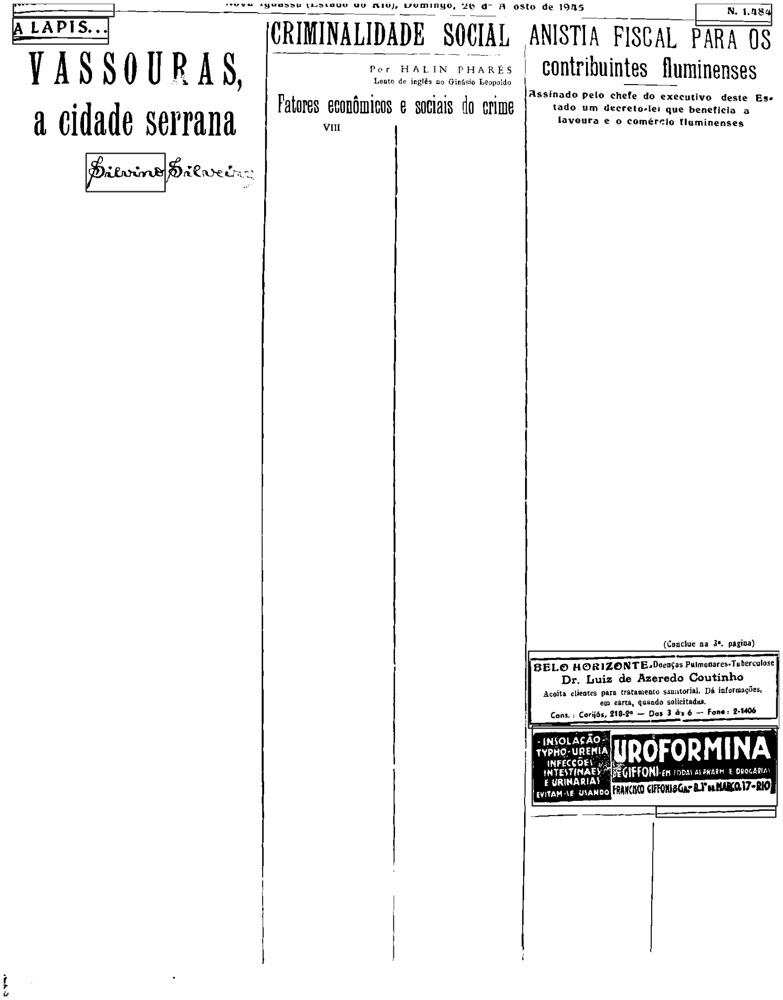

In [166]:
img = img_body.copy()
cnts = cv2.findContours(dilate, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = sorted(cnts, key=lambda x: cv2.boundingRect(x)[0])
i = 0
for c in cnts:
    x, y, w, h = cv2.boundingRect(c)
    if h < 200 and w > 150:
        #roi = img[y:y+h, x:x+w]
        #cv2.imwrite(f'temp/columns/roi_{i}.png', roi)
        
        cv2.rectangle(img, (x, y), (x+w, y+h), (36, 255, 12), 2)
        i += 1
cv2.imwrite('temp/boxes.png', img)
display('temp/boxes.png')

In [159]:
def conflicts(columns, x, y, w, h):
    for c in columns:
        x1, y1, w1, h1 = c
        conflicts_x1 = x >= x1 and x <= x1 + w1
        conflicts_x2 = x + w >= x1 and x + w <= x1 + w1
        conflicts_y1 = y >= y1 and y <= y1 + h1
        conflicts_y2 = y + h >= y1 and y + h <= y1 + h1
        if conflicts_x1 and conflicts_y1 or conflicts_x2 and conflicts_y2:
            return True
    
    return False

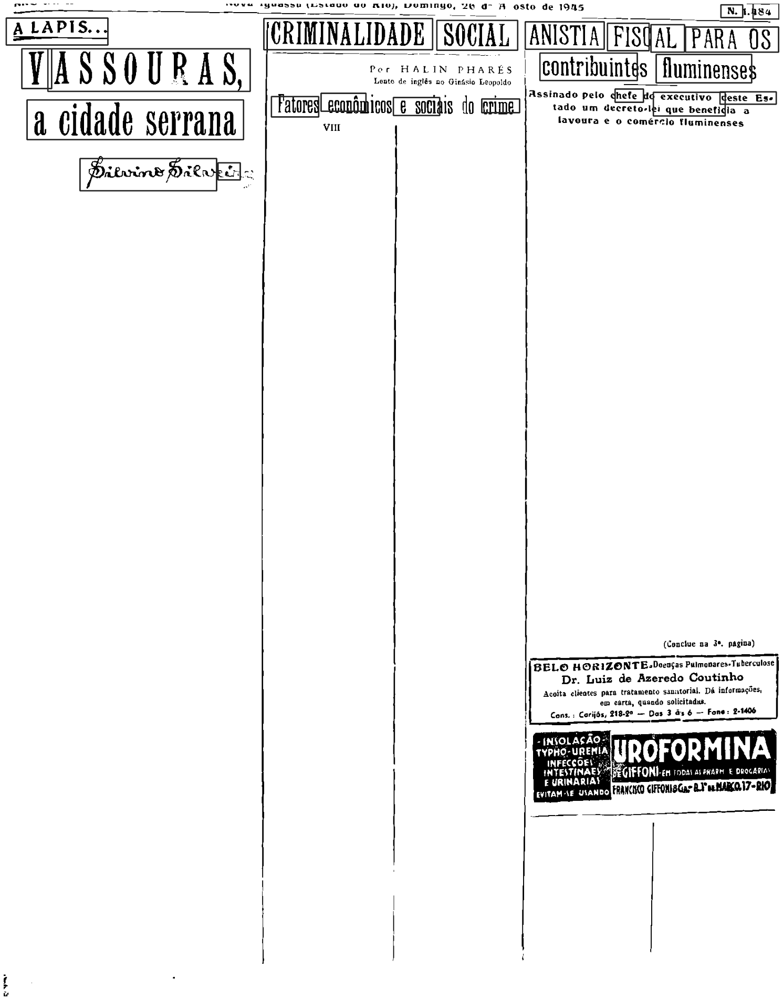

In [160]:
img = img_body.copy()
cnts = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = sorted(cnts, key=lambda x: cv2.boundingRect(x)[0])
i = 0
for c in cnts:
    x, y, w, h = cv2.boundingRect(c)
    #if h > 50 and h < 400 and w > 50 and not conflicts(columns, x, y, w, h):
    if h > 25 and h < 400 and w > 40 and w < 500:
        #roi = img[y:y+h, x:x+w]
        #cv2.imwrite(f'temp/columns/roi_{i}.png', roi)
        cv2.rectangle(img, (x, y), (x+w, y+h), (36, 255, 12), 2)
    i += 1
cv2.imwrite('temp/boxes.png', img)
display('temp/boxes.png')

## Adaptive thresholding

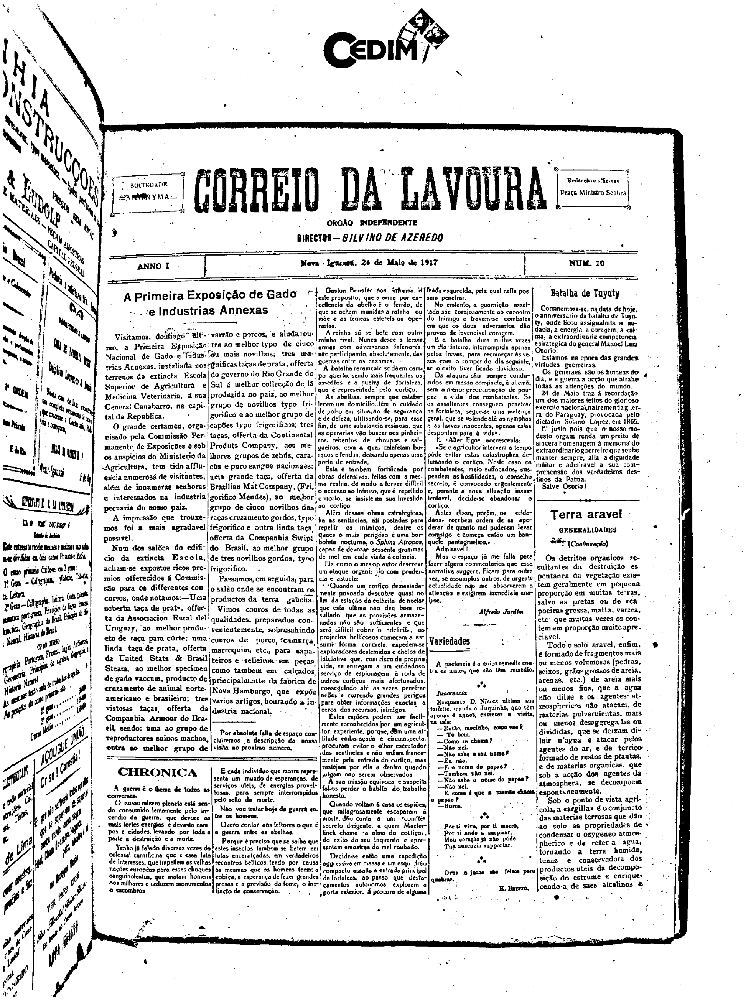

In [4]:
img = cv2.imread('input/processed/Correio da Lavoura_10_Maio_1917/page0001-1.png')
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_bw = cv2.adaptiveThreshold(img_gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 45, 10)
cv2.imwrite('temp/adaptive_bw.png', img_bw)
display('temp/adaptive_bw.png')
# k = 10
# w = img_gray.shape[1] / k
# h = img_gray.shape[0] / k
# img_new = img_gray.copy() * 0
# for i in range(k):
#     for j in range(k):
#         cv2.


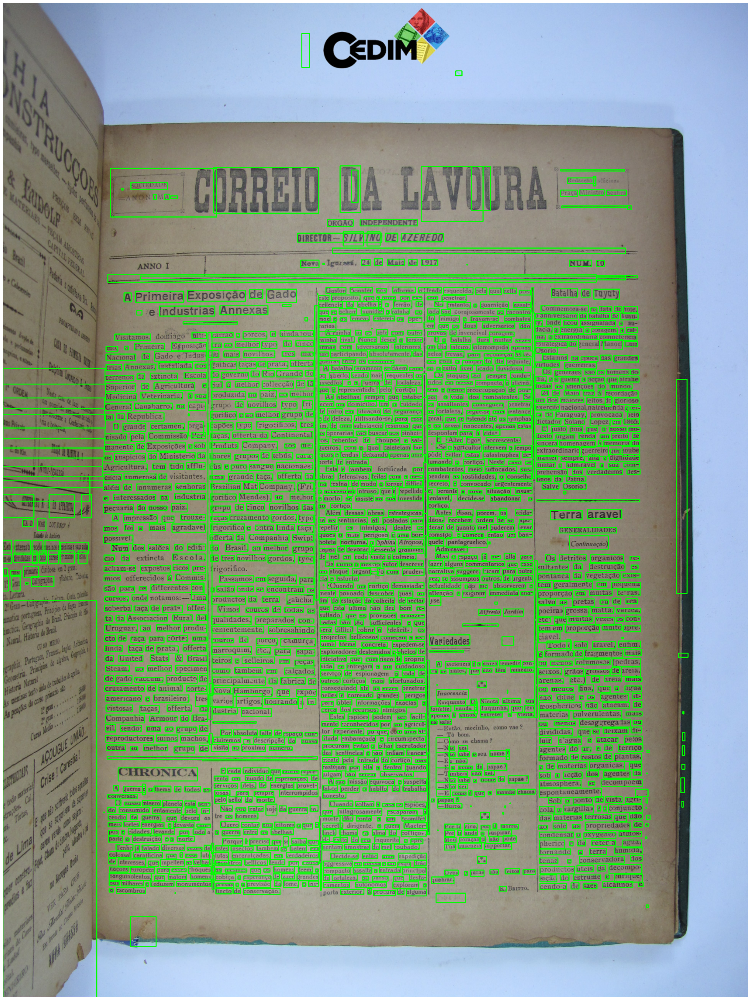

In [15]:
import pytesseract
df = pytesseract.image_to_data(img_bw, lang='por', output_type=pytesseract.Output.DATAFRAME)
df = df.loc[df['conf'] > 0]
im = img.copy()
for index, row in df.iterrows():
    cv2.rectangle(im, (row['left'], row['top']), (row['left'] + row['width'], row['top'] + row['height']), (0, 255, 0), 2)

cv2.imwrite('temp/tess_boxes.png', im)
display('temp/tess_boxes.png')

## Análise de Layout GBN-MHS (Araujo, 2019)

In [3]:
img_bw = cv2.imread('temp/correio da lavoura_10_maio_1917/page0001-1.png', cv2.IMREAD_GRAYSCALE)

In [4]:
_, thresh = cv2.threshold(img_bw, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)
n, mask, cc, centroids = cv2.connectedComponentsWithStats(thresh, connectivity=8, ltype=cv2.CV_32S)

In [5]:
area = np.zeros(n, dtype=np.int)
rect = np.zeros((n, 4), dtype=np.int)
inc = np.zeros(n, dtype=np.int)
hw_rate = np.zeros(n)
for i in range(1, n):
    area[i] = cc[i, cv2.CC_STAT_AREA]
    h = cc[i, cv2.CC_STAT_HEIGHT]
    w = cc[i, cv2.CC_STAT_WIDTH]
    hw_rate[i] = min(w, h) / max(w, h)
    rect[i, [0,1]] = cc[i, [cv2.CC_STAT_LEFT, cv2.CC_STAT_TOP]]
    rect[i, [2,3]] = [w, h]

In [6]:
for i in range(1, n):
    contained = (rect[:, 0] >= rect[i, 0]) & (rect[:, 0] + rect[:, 2] <= rect[i, 0] + rect[i, 2]) & (rect[:, 1] >= rect[i, 1]) & (rect[:, 1] + rect[:, 3] <= rect[i, 1] + rect[i, 3])
    contained[i] = False
    contained = contained & (area >= area[i] * 0.05)
    inc[i] = contained.sum()


In [7]:
is_text = np.full(n, True, dtype=np.bool8)

is_text = is_text & (rect[:, 0] > 0)
is_text = is_text & (rect[:, 1] > 0)
is_text = is_text & (rect[:, 0] + rect[:, 2] < thresh.shape[1])
is_text = is_text & (rect[:, 0] + rect[:, 3] < thresh.shape[0])

is_text = is_text & (inc <= 4)
is_text = is_text & (area >= 6)
is_text = is_text & (hw_rate >= 0.06)
is_text.sum(), n

(8858, 10125)

In [8]:
for non_text in rect[~is_text]:
    x, y, w, h = non_text
    cv2.rectangle(thresh, (x, y), (x+w, y+h), 0, -1)

cv2.imwrite('temp/text_only.png', thresh)
display('temp/text_only.png')

'temp/text_only.png'

In [16]:
def get_gradient(R, s, axis=1, debug=False):
    ph = np.sum(R > 0, axis)
    zh = np.zeros_like(ph)
    # s = int(ph.shape[0] * 0.05)
    for x in range(zh.shape[0]):
        i = max(x - s, 0)
        j = min(x + s, zh.shape[0])
        zh[x] = np.floor(np.mean(ph[i:j]))
    if zh.shape[0] < 2:
        return np.array([0])
    gh = np.round(np.gradient(zh)).astype(np.int)
    
    return gh if not debug else (gh, ph, zh)

def check_homogeneity(R, s):
    gh = get_gradient(R, s)
    lh = [t for t in range(gh.shape[0]-1) if (gh[t] < 0 and gh[t+1] >= 0) or (gh[t] > 0 and gh[t] <= 0)]
    delta = np.array([lh[i+1] - lh[i] for i in range(len(lh)-1)])
    if delta.shape[0] > 0:
        v = np.var(delta)
        return v <= 1.2
    return True
s = int(np.median(rect[is_text,3]) * 2)
check_homogeneity(thresh, s)

False

In [46]:
def get_lines(R, axis, t=0):
    p = np.sum(R > 0, axis=axis)

    flags = np.zeros_like(p, dtype=np.bool)
    heights = np.zeros_like(p)
    prev = p[0]
    
    flags = p > t
    heights[0] = 1
    
    for i in range(1, len(p)):
        if p[i] <= t:
            if prev <= t:
                heights[i] = heights[i-1] + 1
            else:
                heights[i] = 1
        else:
            if prev > t:
                heights[i] = heights[i-1] + 1
            else:
                heights[i] = 1
        
        prev = p[i]
    
    bounds = [b for b in np.argwhere(heights == 1).flatten()] + [heights.shape[0]]
    centers = np.zeros((heights.shape[0], 3), dtype=np.int)
    for b in range(len(bounds) - 1):
        start, end = bounds[b], bounds[b+1]
        heights[start:end] = np.max(heights[start:end])
        centers[start:end, 0] = start
        centers[start:end, 1] = (end + start) // 2
        centers[start:end, 2] = end
        
    return flags, heights, centers

def get_division(R, t=20):
    def copy_slice(ar, slc):
        new = np.zeros_like(ar)
        new[slc] = ar[slc]
        return new
    h_flags, h_heights, h_centers = get_lines(R, 1, t)
    v_flags, v_heights, v_centers = get_lines(R, 0, t)
    
    axis = -1
    index = (-1, -1, -1)
    
    bh_heights = copy_slice(h_heights, ~h_flags)
    bv_heights = copy_slice(v_heights, ~v_flags)
    wh_heights = copy_slice(h_heights, h_flags)
    wv_heights = copy_slice(v_heights, v_flags)
    
    bh = np.argwhere(bh_heights == np.max(bh_heights)).flatten()
    bv = np.argwhere(bv_heights == np.max(bv_heights)).flatten()
    wh = np.argwhere(wh_heights == np.max(wh_heights)).flatten()
    wv = np.argwhere(wv_heights == np.max(wv_heights)).flatten()

    black = True

    if h_heights[bh[0]] > v_heights[bv[0]] and bh[0] > np.median(bh_heights[~h_flags]):
        axis = 0
        black = True
        index = h_centers[bh[0]]
    elif v_heights[bv[0]] > h_heights[bh[0]] and bv[0] > np.median(bv_heights[~v_flags]):
        axis = 1
        black = True
        index = v_centers[bv[0]]
    else:
        if h_heights[wh[0]] > v_heights[wv[0]] and wh[0] > np.median(wh_heights[h_flags]):
            axis = 0
            black = False
            index = h_centers[wh[0]]
        elif v_heights[wv[0]] > h_heights[wh[0]] and wv[0] > np.median(wv_heights[v_flags]):
            axis = 1
            black = False
            index = v_centers[wv[0]]

    
    return axis, black, index

In [39]:
axis, black, k = get_division(thresh, 0)
k = k[0]
# axis, k
if axis == 0:
    r1 = thresh[:k]
    r2 = thresh[k:]
elif axis == 1:
    r1 = thresh[:, :k]
    r2 = thresh[:, k:]
r1.shape, r2.shape

((0, 1896), (2657, 1896))

In [47]:
def recursive_splitting(img, s, t):
    finished_regions = []
    finished_coords = []

    regions = [img]
    coords = [(0, 0, img.shape[1], img.shape[0])]

    all_coords = [coords[0]]

    new_regions = [0]
    while len(new_regions) > 0:
        new_regions = []
        new_homo = []
        new_coords = []
        for i in range(len(regions)):
            print('in', coords[i])
            homo = check_homogeneity(regions[i], s)
            if homo:
                print('homo!')
                finished_regions.append(regions[i])
                finished_coords.append(coords[i])
            else:
                axis, black, index = get_division(regions[i], t)
                
                x, y, w, h = coords[i]
                if axis == 0:
                    cut = [index[1]] if black else [index[0], index[2]]
                    for k in cut:
                        if k > 3 and (x, y, w, k) not in all_coords:
                            new_coords.append((x, y, w, k))
                            new_regions.append(regions[i][:k])
                            all_coords.append(new_coords[-1])
                            print('1.new', new_coords[-1])
                        if k < h-3 and (x, y+k, w, h-k) not in all_coords:
                            new_coords.append((x, y + k, w, h - k))
                            new_regions.append(regions[i][k:])
                            all_coords.append(new_coords[-1])
                            print('2.new', new_coords[-1])
                elif axis == 1:
                    cut = [index[1]] if black else [index[0], index[2]]
                    for k in cut:
                        if k > 3 and (x, y, k, h) not in all_coords:
                            new_coords.append((x, y, k, h))
                            new_regions.append(regions[i][:, :k])
                            all_coords.append(new_coords[-1])
                            print('3.new', new_coords[-1])
                        if k < w-3 and (x+k, y, w-k, h) not in all_coords:
                            new_coords.append((x + k, y, w - k, h))
                            new_regions.append(regions[i][:, k:])
                            all_coords.append(new_coords[-1])
                            print('4.new', new_coords[-1])
                else:
                    print('give up. homo!')
                    # unable to split, consider it homogeneus
                    finished_regions.append(regions[i])
                    finished_coords.append(coords[i])
        print('scanned', len(regions), 'regions.', len(new_regions), 'new regions found')

        regions = new_regions
        homo = new_homo
        coords = new_coords
    
    return finished_regions, finished_coords
    

In [51]:
# t = np.percentile(np.sum(thresh > 0, axis=axis), 25)
rs, cs = recursive_splitting(thresh[250:-100,170:-60], s, 0)
cs

in (0, 0, 1666, 2307)
3.new (0, 0, 1648, 2307)
4.new (1648, 0, 18, 2307)
scanned 1 regions. 2 new regions found
in (0, 0, 1648, 2307)
3.new (0, 0, 1643, 2307)
4.new (1643, 0, 5, 2307)
in (1648, 0, 18, 2307)
homo!
scanned 2 regions. 2 new regions found
in (0, 0, 1643, 2307)
1.new (0, 0, 1643, 2236)
2.new (0, 2236, 1643, 71)
in (1643, 0, 5, 2307)
homo!
scanned 2 regions. 2 new regions found
in (0, 0, 1643, 2236)
3.new (0, 0, 1628, 2236)
4.new (1628, 0, 15, 2236)
in (0, 2236, 1643, 71)
homo!
scanned 2 regions. 2 new regions found
in (0, 0, 1628, 2236)
3.new (0, 0, 1602, 2236)
4.new (1602, 0, 26, 2236)
in (1628, 0, 15, 2236)
homo!
scanned 2 regions. 2 new regions found
in (0, 0, 1602, 2236)
1.new (0, 0, 1602, 2211)
2.new (0, 2211, 1602, 25)
in (1602, 0, 26, 2236)
homo!
scanned 2 regions. 2 new regions found
in (0, 0, 1602, 2211)
give up. homo!
in (0, 2211, 1602, 25)
homo!
scanned 2 regions. 0 new regions found


[(1648, 0, 18, 2307),
 (1643, 0, 5, 2307),
 (0, 2236, 1643, 71),
 (1628, 0, 15, 2236),
 (1602, 0, 26, 2236),
 (0, 0, 1602, 2211),
 (0, 2211, 1602, 25)]

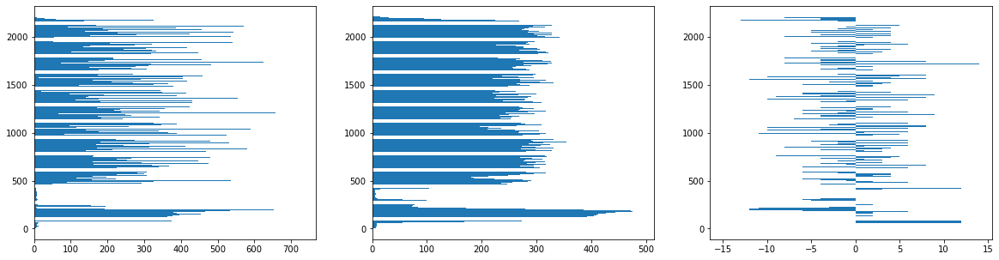

In [43]:
r = thresh[250:-100,170:-60][0:2211,0:1602]
gh, ph, zh = get_gradient(r, s, 1, debug=True)
x = np.arange(ph.shape[0])
fig, axs = plt.subplots(1, 3, figsize=(20, 5))
axs[0].barh(x, ph)
axs[1].barh(x, zh)
axs[2].barh(x, gh)
plt.show()

In [52]:
check_homogeneity(r, s)

False

In [53]:
get_division(r, 0)

(-1, True, (-1, -1, -1))

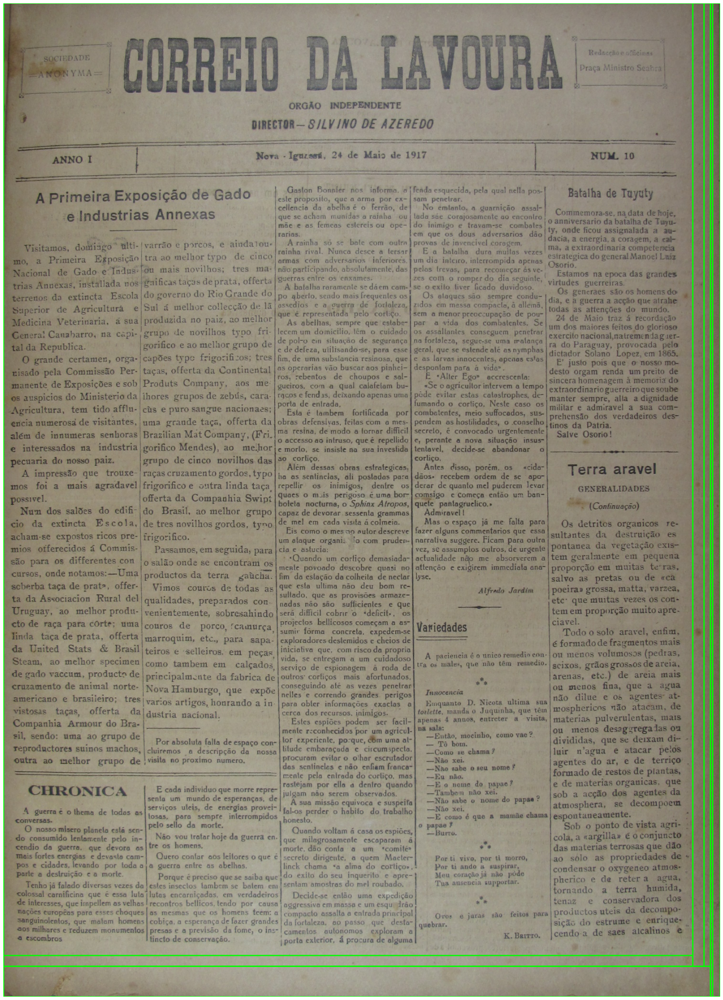

In [42]:
img_boxes = cv2.imread('temp/correio da lavoura_10_maio_1917/page0001-1/cropped.png')[250:-100,170:-60]
for r in cs:
    x,y,w,h = r
    cv2.rectangle(img_boxes, (x,y), (x+w,y+h), (0, 255, 0), 2)
cv2.imwrite('temp/boxes.png', img_boxes)
display('temp/boxes.png')